In [1]:
import sys, os
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import torch
import argparse
import wandb
import logging
import pickle

root_dir = r'../..'
SEED = 42
TOL_FP = 1e-12

plt.rc('font', size=18)#weight='bold', 
plt.rc('legend', fontsize=18)
plt.rc('lines', linewidth=3, markersize=9)
mpl.rcParams['axes.grid'] = True

markers = ['o','^','s','p','d']
colors = ['b','g','r','c','m','y']

# Config

In [2]:
from sklearn.model_selection import train_test_split
import argparse

parser = argparse.ArgumentParser('W2S - UTKFace')
parser.add_argument('--seed', type=int, default=42, help='Random seed')
parser.add_argument('--test_size', type=int, default=3708, help='Test set size')
parser.add_argument('--batch_size', type=int, default=32, help='Batch size')
parser.add_argument('--cutoff', type=float, default=0.99, help='Intrinsic dimension cutoff ratio')
parser.add_argument('--device', type=str, default='cuda' if torch.cuda.is_available() else 'cpu', help='Device')
parser.add_argument('--tol_fp', type=float, default=1e-6, help='Floating point tolerance')
args = parser.parse_args('')

# Dataset

In [23]:
def get_intrinsic_dim(features, ratio=0.95, return_sval=False): 
    features = features.detach().cpu()
    sval = torch.linalg.svdvals(features)
    cumsum_sval = torch.cumsum(sval**2, dim=0)
    intrinsic_dim = torch.where(cumsum_sval >= ratio*cumsum_sval[-1])[0][0] + 1
    # intrinsic_dim = torch.where(sval**2 < 1e-3 * sval[0]**2)[0][0]
    if return_sval:
        return intrinsic_dim, sval
    return intrinsic_dim


def match_feature_dim(feaw, feas, seed):
    if feaw.shape[1] == feas.shape[1]:
        return feaw, feas
    feaw_ = feaw.clone().detach()
    feas_ = feas.clone().detach()
    d = min(feaw_.shape[1], feas_.shape[1])
    rng = torch.Generator().manual_seed(seed)
    if feaw_.shape[1] > d:        
        feaw_ = feaw_ @ torch.randn(feaw_.shape[1], d, device=feaw_.device, generator=rng) / np.sqrt(d)
    elif feas_.shape[1] > d:
        feas_ = feas_ @ torch.randn(feas_.shape[1], d, device=feas_.device, generator=rng) / np.sqrt(d)
    return feaw_, feas_


def get_correlation_dim(feaw, feas, idimw, idims, seed=42, mode='pad'):
    if mode == 'pad':
        return get_correlation_dim_pad(feaw, feas, idimw, idims)
    elif mode == 'sketch':
        feaw_, feas_ = match_feature_dim(feaw, feas, seed)
        covar_w = feaw_.T @ feaw_ / feaw_.shape[0]
        _, evec_w = torch.linalg.eigh(covar_w)
        V_w = evec_w[:, -idimw:]
        covar_s = feas_.T @ feas_ / feas_.shape[0]
        _, evec_s = torch.linalg.eigh(covar_s)
        V_s = evec_s[:, -idims:]
        canonical_angles = torch.linalg.svdvals(V_w.T @ V_s)
        correlation_dim = torch.sum(canonical_angles**2)
        return correlation_dim
    else:
        raise ValueError('Invalid mode!')


def get_correlation_dim_pad(feaw, feas, idimw, idims):
    feaw_ = feaw.clone().detach()
    feas_ = feas.clone().detach()
    if feaw_.shape[1]!=feas_.shape[1]:
        d = max(feaw_.shape[1], feas_.shape[1])
        if feaw_.shape[1] < d:
            feaw_ = torch.cat([feaw_, torch.zeros(feaw_.shape[0], d-feaw_.shape[1], device=feaw_.device)], dim=1)
        elif feas_.shape[1] < d:
            feas_ = torch.cat([feas_, torch.zeros(feas_.shape[0], d-feas_.shape[1], device=feas_.device)], dim=1)
    covar_w = feaw_.T @ feaw_ / feaw_.shape[0]
    _, evec_w = torch.linalg.eigh(covar_w)
    V_w = evec_w[:, -idimw:]
    covar_s = feas_.T @ feas_ / feas_.shape[0]
    _, evec_s = torch.linalg.eigh(covar_s)
    V_s = evec_s[:, -idims:]
    canonical_angles = torch.linalg.svdvals(V_w.T @ V_s)
    correlation_dim = torch.sum(canonical_angles**2)
    return correlation_dim


def get_correlation_dim_sketched(feaw, feas, idimw, idims, dim_lift=None, seed=42):
    idim = max(idimw, idims) + 10
    if dim_lift is None:
        dim_lift = max(feaw.shape[1], feas.shape[1])
        
    rng = torch.Generator().manual_seed(seed)
    embed_w = torch.randn(feaw.shape[1], idim, device=feaw.device, generator=rng) / np.sqrt(idimw)
    embed_s = torch.randn(feas.shape[1], idim, device=feas.device, generator=rng) / np.sqrt(idims)
    lift_w = torch.randn(idim, dim_lift, device=feaw.device, generator=rng) / np.sqrt(dim_lift)
    lift_s = torch.randn(idim, dim_lift, device=feas.device, generator=rng) / np.sqrt(dim_lift)
    feaw_ = feaw @ embed_w @ lift_w
    feas_ = feas @ embed_s @ lift_s
    correlation_dim = get_correlation_dim_pad(feaw_, feas_, idimw, idims)
    return correlation_dim

In [4]:
path_dict = {
    'resnet18': "./precomputed/utkface_resnet18.pt", # (23705, 512)
    'resnet34': "./precomputed/utkface_resnet34.pt", # (23705, 512)
    'resnet50': "./precomputed/utkface_resnet50.pt", # (23705, 2048)
    'resnet101': "./precomputed/utkface_resnet101.pt", # (23705, 2048)
    'resnet152': "./precomputed/utkface_resnet152.pt", # (23705, 2048)
    'clipb32': "./precomputed/utkface_clipb32.pt", # (23705, 768)
    'labels': "./precomputed/utkface_labels.pt" # (23705,)
}

features_s = torch.load(path_dict['clipb32']) 
labels = torch.load(path_dict['labels'])
weaks = ['resnet18', 'resnet34', 'resnet50', 'resnet101', 'resnet152']
idim_dict = {}
sval_dict = {}
cdim_dict = {}

student = 'clipb32'
int_dim, sval = get_intrinsic_dim(features_s, ratio=args.cutoff, return_sval=True)
idim_dict[student] = int_dim
sval_dict[student] = sval

for weak in weaks:
    features_w = torch.load(path_dict[weak])
    int_dim, sval = get_intrinsic_dim(features_w, ratio=args.cutoff, return_sval=True)
    idim_dict[weak] = int_dim
    sval_dict[weak] = sval
    cdim = get_correlation_dim(features_w, features_s, int_dim, idim_dict[student])
    cdim_dict[weak] = cdim
    # print(f'{weak}: {int_dim}, {cdim}')

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


Dataset size: 23708
--------------------------------------------------
clipb32 intrinsic dim: 443/768 = 0.5768
resnet18 intrinsic dim: 194/512 = 0.3789
resnet34 intrinsic dim: 150/512 = 0.2930
resnet50 intrinsic dim: 522/2048 = 0.2549
resnet101 intrinsic dim: 615/2048 = 0.3003
resnet152 intrinsic dim: 589/2048 = 0.2876
--------------------------------------------------
resnet18 correlation dim: 113.0227279663086/194 = 0.5826
resnet34 correlation dim: 86.76770782470703/150 = 0.5785
resnet50 correlation dim: 117.91432189941406/443 = 0.2662
resnet101 correlation dim: 136.88919067382812/443 = 0.3090
resnet152 correlation dim: 125.97468566894531/443 = 0.2844
--------------------------------------------------


Text(0.5, 1.0, 'Cutoff ratio = 0.99 (UTKFace)')

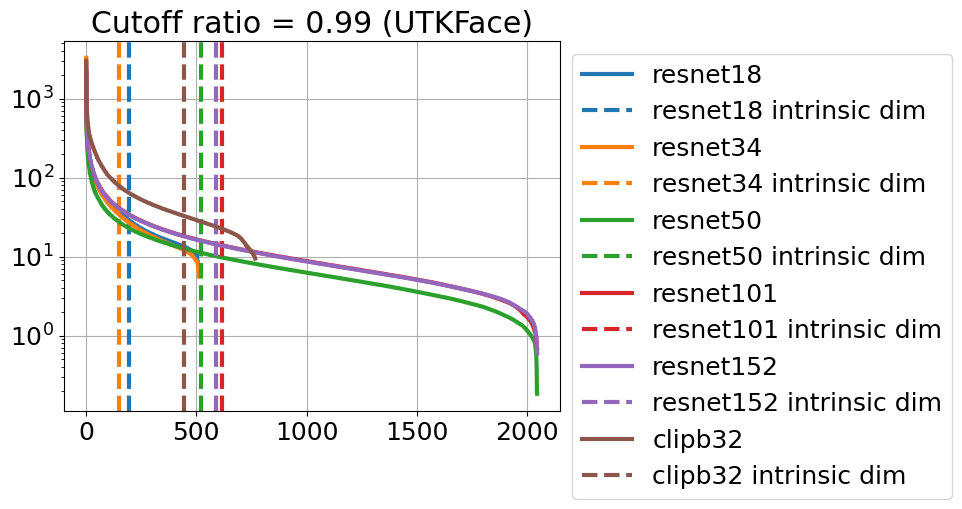

In [12]:
print(f'Dataset size: {labels.shape[0]}')
print('-'*50)
print(f'{student} intrinsic dim: {idim_dict[student]}/{sval_dict[student].shape[0]} = {idim_dict[student]/sval_dict[student].shape[0]:.4f}')
for weak in weaks:
    print(f'{weak} intrinsic dim: {idim_dict[weak]}/{sval_dict[weak].shape[0]} = {idim_dict[weak]/sval_dict[weak].shape[0]:.4f}')
print('-'*50)
for weak in weaks:
    print(f'{weak} correlation dim: {cdim_dict[weak]}/{min(idim_dict[weak], idim_dict[student])} = {cdim_dict[weak]/min(idim_dict[weak], idim_dict[student]):.4f}')
print('-'*50)


for weak in weaks:
    line = plt.plot(sval_dict[weak], label=weak)
    plt.axvline(idim_dict[weak], linestyle='--', color=line[0].get_color(), label=f'{weak} intrinsic dim')
line = plt.plot(sval_dict[student], label=student)
plt.axvline(idim_dict[student], linestyle='--', color=line[0].get_color(), label=f'{student} intrinsic dim')
plt.legend(loc='upper left', bbox_to_anchor=(1,1))
plt.yscale('log')
plt.title(f'Cutoff ratio = {args.cutoff} (UTKFace)')

## Correlation dimension after sketching

In [33]:
student = 'clipb32'
weaks = ['resnet18', 'resnet34', 'resnet50','resnet101', 'resnet152']
features_s = torch.load(path_dict[student]) 
labels = torch.load(path_dict['labels'])
idim_dict = {}
sval_dict = {}
cdim_dict = {}
skcdim_dict = {}

int_dim, sval = get_intrinsic_dim(features_s, ratio=args.cutoff, return_sval=True)
idim_dict[student] = int_dim
sval_dict[student] = sval

for weak in weaks:
    features_w = torch.load(path_dict[weak])
    int_dim, sval = get_intrinsic_dim(features_w, ratio=args.cutoff, return_sval=True)
    idim_dict[weak] = int_dim
    sval_dict[weak] = sval
    cdim = get_correlation_dim(features_w, features_s, int_dim, idim_dict[student])
    cdim_dict[weak] = cdim
    dim_lift = int(np.ceil(max(features_w.shape[1], features_s.shape[1]) * 1.5))
    skcdim = get_correlation_dim_sketched(features_w, features_s, int_dim, idim_dict[student], dim_lift=dim_lift)
    skcdim_dict[weak] = skcdim

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


In [34]:
# Sketched correlation dimension
print(f'Dataset size: {labels.shape[0]}')
print('-'*50)
for weak in weaks:
    print(f'{weak} intrinsic dim: {idim_dict[weak]}/{sval_dict[weak].shape[0]} = {idim_dict[weak]/sval_dict[weak].shape[0]:.4f}')
print('-'*50)
for weak in weaks:
    print(f'{weak} correlation dim: {cdim_dict[weak]}/{min(idim_dict[weak], idim_dict[student])} = {cdim_dict[weak]/min(idim_dict[weak], idim_dict[student]):.4f}')
    print(f'{weak} sketched correlation dim: {skcdim_dict[weak]}/{min(idim_dict[weak], idim_dict[student])} = {skcdim_dict[weak]/min(idim_dict[weak], idim_dict[student]):.4f}')
print('-'*50)


# for weak in weaks:
#     line = plt.plot(sval_dict[weak], label=weak)
#     plt.axvline(idim_dict[weak], linestyle='--', color=line[0].get_color(), label=f'{weak} intrinsic dim')
# line = plt.plot(sval_dict[student], label=student)
# plt.axvline(idim_dict[student], linestyle='--', color=line[0].get_color(), label=f'{student} intrinsic dim')
# plt.legend(loc='upper left', bbox_to_anchor=(1,1))
# plt.yscale('log')
# plt.title(f'Cutoff ratio = {args.cutoff} (UTKFace)')

Dataset size: 23708
--------------------------------------------------
resnet18 intrinsic dim: 194/512 = 0.3789
resnet34 intrinsic dim: 150/512 = 0.2930
resnet50 intrinsic dim: 522/2048 = 0.2549
resnet101 intrinsic dim: 615/2048 = 0.3003
resnet152 intrinsic dim: 589/2048 = 0.2876
--------------------------------------------------
resnet18 correlation dim: 113.0227279663086/194 = 0.5826
resnet18 sketched correlation dim: 74.42086791992188/194 = 0.3836
resnet34 correlation dim: 86.76770782470703/150 = 0.5785
resnet34 sketched correlation dim: 57.537147521972656/150 = 0.3836
resnet50 correlation dim: 117.91432189941406/443 = 0.2662
resnet50 sketched correlation dim: 75.2695083618164/443 = 0.1699
resnet101 correlation dim: 136.88919067382812/443 = 0.3090
resnet101 sketched correlation dim: 88.65137481689453/443 = 0.2001
resnet152 correlation dim: 125.97468566894531/443 = 0.2844
resnet152 sketched correlation dim: 84.71050262451172/443 = 0.1912
----------------------------------------------

# Models

In [28]:
def rsvd(X, rank, oversampling=10, seed=42):
    rng = torch.Generator().manual_seed(seed)
    embedding = torch.randn(X.shape[1], rank+oversampling, device=X.device, dtype=X.dtype, generator=rng) / np.sqrt(rank+oversampling) #(d, k+p)
    Q, _ = torch.linalg.qr(X @ embedding) #(n, k+p)
    B = Q.T @ X #(k+p, d)
    U, sval, Vh = torch.linalg.svd(B, full_matrices=False) #(k+p, k+p), (k+p), (k+p, d)
    U = Q @ U #(n, k+p)
    V = Vh.T #(d, k+p)
    return U, sval, V
    
def train_linear_regression(features, labels, intrinsic_dim, seed=42):
    rng = torch.Generator().manual_seed(seed)
    embedding = torch.randn(features.shape[1], intrinsic_dim, device=features.device, dtype=features.dtype, generator=rng) / np.sqrt(intrinsic_dim) # (d, d_w)
    features_sketch = features @ embedding # (N, d_w)
    theta_embedded = torch.linalg.lstsq(features_sketch, labels, rcond=args.tol_fp).solution # (d_w, 1)
    theta = embedding @ theta_embedded # (d, 1)
    prediction = lambda x: x @ theta
    return prediction

def train_ridge_regression(features, labels, ridge, nrank=768, seed=42):
    if features.shape[1] > nrank:
        U, sval, V = rsvd(features, rank=nrank, seed=seed)
    else:
        U, sval, Vh = torch.linalg.svd(features, full_matrices=False)
        V = Vh.T
    ridge_diag = sval/(sval**2 + ridge)
    theta = V @ (ridge_diag * (U.T @ labels))
    prediction = lambda x: x @ theta
    return prediction

def eval_linear_probe(prediction, features, labels):
    preds = prediction(features)
    mse = torch.mean((preds - labels)**2).item()
    return mse

def linear_probe(train, test, int_dim=0, ridge=1e-6, seed=42):
    fea_train, lab_train = train 
    fea_test, lab_test = test
    if int_dim<=0:
        prediction = train_ridge_regression(fea_train, lab_train, ridge, seed=seed)
    else:
        prediction = train_linear_regression(fea_train, lab_train, int_dim, seed=seed)
    mse_train = eval_linear_probe(prediction, fea_train, lab_train)
    mse_test = eval_linear_probe(prediction, fea_test, lab_test)
    return mse_test, mse_train

## Test

In [29]:
weak_tag = 'resnet34'
strong_tag = 'clipb32'
features_dict = {
    'resnet18': torch.load("./precomputed/utkface_resnet18.pt"), #(23705, 512)
    'resnet34': torch.load("./precomputed/utkface_resnet34.pt"), #(23705, 512)
    'resnet50': torch.load("./precomputed/utkface_resnet50.pt"), #(23705, 2048) **ResNet50 is better than ResNet101**
    'resnet101': torch.load("./precomputed/utkface_resnet101.pt"), #(23705, 2048)
    'resnet152': torch.load("./precomputed/utkface_resnet152.pt"), #(23705, 2048)
    'clipb32': torch.load("./precomputed/utkface_clipb32.pt") #(23705, 768)
}
features_w = features_dict[weak_tag]
features_s = features_dict[strong_tag]
labels = torch.load("./precomputed/utkface_labels.pt").float() #(23705,)
ridge = 1e-8
n = int(2e4)

train_index, test_index = train_test_split(range(labels.shape[0]), test_size=args.test_size, random_state=args.seed, shuffle=True)
fea_train, lab_train = features_w[train_index[:n]], labels[train_index[:n]]
fea_test, lab_test = features_w[test_index], labels[test_index]
# mse_test, mse_train = linear_probe((fea_train, lab_train), (fea_test, lab_test), int_dim=int_dim_w, seed=args.seed)
mse_test, mse_train = linear_probe((fea_train, lab_train), (fea_test, lab_test), ridge=ridge, seed=args.seed)

In [6]:
print(f'Train size: {len(train_index)}, Test size: {len(test_index)}')
print(f'Linear probe {weak_tag} MSE: Train = {mse_train:.4f}, Test = {mse_test:.4f}')

Train size: 20000, Test size: 3708
Linear probe resnet34 MSE: Train = 143.6489, Test = 158.7576


In [7]:
fea_train, lab_train = features_s[train_index[:n]], labels[train_index[:n]]
fea_test, lab_test = features_s[test_index], labels[test_index]
# mse_test, mse_train = linear_probe((fea_train, lab_train), (fea_test, lab_test), int_dim_s, seed=args.seed)
mse_test, mse_train = linear_probe((fea_train, lab_train), (fea_test, lab_test), ridge=ridge, seed=args.seed)

In [8]:
print(f'Linear probe {strong_tag} MSE: Train = {mse_train:.4f}, Test = {mse_test:.4f}')

Linear probe clipb32 MSE: Train = 39.5483, Test = 40.9892


# Linear prober

In [30]:
fea_path_dict = {
    'resnet18': "./precomputed/utkface_resnet18.pt", #(23705, 512)
    'resnet34': "./precomputed/utkface_resnet34.pt", #(23705, 512)
    'resnet50': "./precomputed/utkface_resnet50.pt", #(23705, 2048)
    'resnet101': "./precomputed/utkface_resnet101.pt", #(23705, 2048)
    'resnet152': "./precomputed/utkface_resnet152.pt", #(23705, 2048)
    'clipb32': "./precomputed/utkface_clipb32.pt" #(23705, 768)
}

model_label_dict = {
    'resnet18': 'ResNet18',
    'resnet34': 'ResNet34',
    'resnet50': 'ResNet50',
    'resnet101': 'ResNet101',
    'resnet152': 'ResNet152',
    'clipb32': 'CLIP-B32'
}

class W2S_UTKFace:
    def __init__(self, args, weak_tag='resnet18', strong_tag='resnet152', ridge=1e-6, noise=0.0):
        self.args = args
        self.weak_tag = weak_tag
        self.strong_tag = strong_tag
        self.labels = torch.load("./precomputed/utkface_labels.pt").float()
        self.noise = noise
        self.ridge = ridge
        # load features
        self.fea_w = torch.load(fea_path_dict[weak_tag])
        self.fea_s = torch.load(fea_path_dict[strong_tag])
        # intrinsic dimension + correlation dimension
        self.dw = self.get_intrinsic_dim(self.fea_w, ratio=args.cutoff)
        self.ds = self.get_intrinsic_dim(self.fea_s, ratio=args.cutoff)
        self.dsw = self.get_correlation()
        # train-test split
        idx_train, idx_test = train_test_split(range(self.labels.shape[0]), test_size=args.test_size, random_state=args.seed, shuffle=True)
        self.idx_train = idx_train
        self.idx_test = idx_test
        # artificial noise
        if self.noise > 0:
            self.labels[idx_train] = self.labels[idx_train] + self.noise * torch.randn(len(idx_train))
        
    def get_intrinsic_dim(self, fea, ratio):
        return get_intrinsic_dim(fea, ratio=ratio, return_sval=False)
        
    def get_correlation(self,): 
        return get_correlation_dim(self.fea_w, self.fea_s, self.dw, self.ds)
    
    # def get_estimation_error(self,):
    #     return None
    
    def run_simulation_(self, n, N, ridge=1e-6, seed=42, verbose=True):
        # SFT - W2S split
        idx_sft, idx_w2s = train_test_split(self.idx_train, train_size=int(n), test_size=int(N), shuffle=True, random_state=seed)
        fea_w_sft, fea_s_sft = self.fea_w[idx_sft], self.fea_s[idx_sft]
        fea_w_w2s, fea_s_w2s = self.fea_w[idx_w2s], self.fea_s[idx_w2s]
        fea_w_all, fea_s_all = torch.cat([fea_w_sft, fea_w_w2s]), torch.cat([fea_s_sft, fea_s_w2s])
        fea_w_test, fea_s_test = self.fea_w[self.idx_test], self.fea_s[self.idx_test]
        lab_sft, lab_w2s, lab_test = self.labels[idx_sft], self.labels[idx_w2s], self.labels[self.idx_test]
        lab_all = torch.cat([lab_sft, lab_w2s])

        # Weak teacher
        fun_w = train_ridge_regression(fea_w_sft, lab_sft, ridge)
        mse_w = eval_linear_probe(fun_w, fea_w_test, lab_test)
        # Strong baseline
        fun_s = train_ridge_regression(fea_s_sft, lab_sft, ridge)
        mse_s = eval_linear_probe(fun_s, fea_s_test, lab_test)
        # Strong ceiling
        fun_c = train_ridge_regression(fea_s_all, lab_all, ridge)
        mse_c = eval_linear_probe(fun_c, fea_s_test, lab_test)
        # W2S
        y_w2s = fun_w(fea_w_w2s)
        fun_w2s = train_ridge_regression(fea_s_w2s, y_w2s, ridge)
        mse_w2s = eval_linear_probe(fun_w2s, fea_s_test, lab_test)
        
        pgr = (mse_w - mse_w2s) / (mse_w - mse_c)
        opr = mse_s / mse_w2s
        if verbose:
            print(f'n = {int(n)}, N = {int(N)} | excess risk: w={mse_w:.2f}, s={mse_s:.2f}, c={mse_c:.2f}, w2s={mse_w2s:.2f} | PGR={pgr:.2f}, OPR={opr:.2f}')
        return mse_w2s, mse_w, mse_s, mse_c, pgr, opr
    
    def run_simulation(self, n, N, ridge=1e-6, trials=1, verbose=True):
        pgrs = []
        oprs = []
        er_w2ss = []
        er_ws = []
        er_ss = []
        er_cs = []
        for i in range(trials):
            er_w2s, er_w, er_s, er_c, pgr, opr = self.run_simulation_(n, N, ridge=ridge, seed=i, verbose=False)
            pgrs.append(pgr)
            oprs.append(opr)
            er_w2ss.append(er_w2s)
            er_ws.append(er_w)
            er_ss.append(er_s)
            er_cs.append(er_c)
        if verbose:
            print(f'n = {int(n)}, N = {int(N)} | PGR={pgr:.2f}, OPR={opr:.2f}, W2S={er_w2s:.2f}, Weak={er_w:.2f}, StrongBase={er_s:.2f}, StrongCeiling={er_c:.2f}')
        results = {
            'ew2s': (torch.mean(torch.tensor(er_w2ss)), torch.std(torch.tensor(er_w2ss))),
            'ew': (torch.mean(torch.tensor(er_ws)), torch.std(torch.tensor(er_ws))),
            'es': (torch.mean(torch.tensor(er_ss)), torch.std(torch.tensor(er_ss))),
            'ec': (torch.mean(torch.tensor(er_cs)), torch.std(torch.tensor(er_cs))),
            'pgr': (torch.mean(torch.tensor(pgrs)), torch.std(torch.tensor(pgrs))),
            'opr': (torch.mean(torch.tensor(oprs)), torch.std(torch.tensor(oprs))),
        }
        return results
    
    # def bd_exrisk_w2s(self, n, N):
    #     variance = self.var * (self.dsw + (self.dw - self.dsw) * self.ds / N) / (n - self.dw - 1)
    #     bias = self.esterr_w + self.esterr_s
    #     return variance + bias
    
    # def bd_exrisk_w(self, n, N):
    #     exrisk = (self.var * self.dw / n) + self.esterr_w
    #     if exrisk.shape == torch.Size([]):
    #         exrisk = exrisk * torch.ones(len(N))
    #     return exrisk

    # def bd_exrisk_s(self, n, N):
    #     exrisk = (self.var * self.ds / n) + self.esterr_s
    #     if exrisk.shape == torch.Size([]):
    #         exrisk = exrisk * torch.ones(len(N))
    #     return exrisk
    
    # def bd_exrisk_c(self, n, N):
    #     return (self.var * self.ds / (n + N)) + self.esterr_s
    
    # def bd_pgr(self, n, N):
    #     er_w2s = self.bd_exrisk_w2s(n, N)
    #     er_w = self.bd_exrisk_w(n, N)
    #     er_c = self.bd_exrisk_c(n, N)
    #     pgr = (er_w - er_w2s) / (er_w - er_c)
    #     return pgr
    
    # def bd_opr(self, n, N):
    #     er_s = self.bd_exrisk_s(n, N)
    #     er_w2s = self.bd_exrisk_w2s(n, N)
    #     opr = er_s / er_w2s
    #     return opr

# Scaling MSE

In [31]:
legend_dict = {
    'ew2s': 'W2S',
    'ew': 'Weak',
    'es': 'S-Baseline',
    'ec': 'S-Ceiling',
    'pgr': 'PGR',
    'opr': 'OPR',
}

# bounds_dict = {
#     'ew2s': lambda n, N, simulator: simulator.bd_exrisk_w2s(n, N),
#     'ew': lambda n, N, simulator: simulator.bd_exrisk_w(n, N),
#     'es': lambda n, N, simulator: simulator.bd_exrisk_s(n, N),
#     'ec': lambda n, N, simulator: simulator.bd_exrisk_c(n, N),
#     'pgr': lambda n, N, simulator: simulator.bd_pgr(n, N),
#     'opr': lambda n, N, simulator: simulator.bd_opr(n, N),
# }


def simulation_sample_scale(simulator, 
    n_range=[110, 400], N_range=[1000, 4000], nstart=None, Nstart=None,
    npts=20, nlines=3, trials=10
):
    N_min, N_max = N_range
    n_min, n_max = n_range
    nstart = n_min*2 if nstart is None else nstart
    Nstart = N_min*10 if Nstart is None else Nstart
    metrics = ['ew2s', 'ew', 'es', 'ec', 'pgr', 'opr']

    nn = torch.linspace(nstart, n_max, nlines, dtype=int)
    NN = torch.linspace(N_min, N_max, npts, dtype=int)
    val_scal_N = {m: (torch.zeros(nlines, npts), torch.zeros(nlines, npts)) for m in metrics}
    val_scal_N['nn'] = nn
    val_scal_N['NN'] = NN
    for i, n in enumerate(nn):
        for j, N in enumerate(NN):
            results = simulator.run_simulation(n, N, trials=trials, verbose=False)
            for key, val in results.items():
                mean, std = val
                val_scal_N[key][0][i,j] = mean
                val_scal_N[key][1][i,j] = std
            if j==0:
                print(f'n = {n}')
    print("Scaling N done")
                
    NN = torch.linspace(Nstart, N_max, nlines, dtype=int)
    nn = torch.linspace(n_min, n_max, npts, dtype=int)
    val_scal_n = {m: (torch.zeros(nlines, npts), torch.zeros(nlines, npts)) for m in metrics}
    val_scal_n['nn'] = nn
    val_scal_n['NN'] = NN
    for i, N in enumerate(NN):
        for j, n in enumerate(nn):
            results = simulator.run_simulation(n, N, trials=trials, verbose=False)
            for key, val in results.items():
                mean, std = val
                val_scal_n[key][0][i,j] = mean
                val_scal_n[key][1][i,j] = std
            if j==0:
                print(f'N = {N}')
    print("Scaling n done")
    
    return val_scal_N, val_scal_n

## Run

In [33]:
weak_tag = 'resnet152'
strong_tag = 'clipb32'
ridge = 1e-6
simulator = W2S_UTKFace(args, weak_tag=weak_tag, strong_tag=strong_tag, ridge=ridge,)

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


In [34]:
print(f'Intrinsic dims: weak = {simulator.dw}, strong = {simulator.ds} | Correlation dim = {simulator.dsw}')
print(f'Total training: {len(simulator.idx_train)}, Total testing: {len(simulator.idx_test)}')

Intrinsic dims: weak = 589, strong = 443 | Correlation dim = 339.8995056152344
Total training: 20000, Total testing: 3708


In [35]:
nstart = 1000
N_min = 1000
N_max = 18000

Nstart = 10000
n_min = 800
n_max = 3000

val_scal_N, val_scal_n = simulation_sample_scale(simulator, n_range=[n_min, n_max], N_range=[N_min, N_max], nstart=nstart, Nstart=Nstart, trials=10, nlines=1, npts=20)
name = f'utkface_{weak_tag}_{strong_tag}_ridge{ridge}_n{n_min}-{n_max}_N{N_min}-{N_max}_nstart{nstart}_Nstart{Nstart}'
# with open(f'./results/{name}.pkl', 'rb') as f:
#     val_scal_N, val_scal_n = pickle.load(f)

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


## Plot

(<Figure size 1700x500 with 2 Axes>,
 [<matplotlib.legend.Legend at 0x7fa910e778e0>])

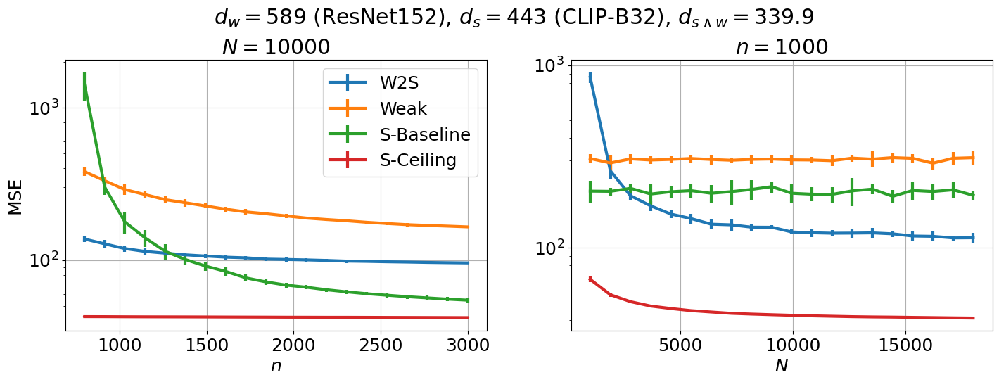

In [36]:
def plot_sample_scale(val_scal_N, val_scal_n, simulator, metrics=['ew2s', 'ew', 'es', 'ec'], ylabel='MSE', ylog=True, ncol_legend=4):
    dw = simulator.dw
    ds = simulator.ds
    dsw = simulator.dsw
    # var = simulator.var
    # esterr_w = simulator.esterr_w
    # esterr_s = simulator.esterr_s
    
    fig = plt.figure(figsize=(17, 5))
    lgds = []
    ax = fig.add_subplot(122)
    nn = val_scal_N['nn']
    NN = val_scal_N['NN']
    for i, n in enumerate(nn):
        for met in metrics:
            val = val_scal_N[met][0][i]
            val_std = val_scal_N[met][1][i]
            line = ax.errorbar(NN, val, yerr=val_std, label=legend_dict[met], fmt='-')
            # if met in bounds:
            #     bd = bounds_dict[met](n, NN, simulator)
            #     if met in ['ew','es']:
            #         bd *= 1.1
            #     ax.plot(NN, bd, label=f"{legend_dict[met]} Bound", color=line[0].get_color(), linestyle=':')
    if ylog:
        ax.set_yscale('log')
    ax.set_xlabel("$N$")
    ax.set_title(f'$n={n}$')

    ax = fig.add_subplot(121)
    NN = val_scal_n['NN']
    nn = val_scal_n['nn']
    for i, N in enumerate(NN):
        for met in metrics:
            val = val_scal_n[met][0][i]
            val_std = val_scal_n[met][1][i]
            line = ax.errorbar(nn, val, yerr=val_std, label=legend_dict[met], fmt='-')
            # if met in bounds:
            #     bd = bounds_dict[met](nn, N, simulator)
            #     if met in ['ew','es']:
            #         bd *= 1.1
            #     ax.plot(nn, bd, label=f"{legend_dict[met]} Bound", color=line[0].get_color(), linestyle=':')
    if ylog:
        ax.set_yscale('log')
    ax.set_xlabel("$n$")
    ax.set_title(f'$N={N}$')
    ax.set_ylabel(ylabel)
    # ax.set_yticks([1e-4, 1e-3])
    handles, labels = ax.get_legend_handles_labels()
    lgd = ax.legend(handles, labels,)
    # lgd = ax.legend(handles, labels, loc='upper left', bbox_to_anchor=(0.3, -0.12), ncol=ncol_legend)
    lgds.append(lgd)
    
    teacher_tag = model_label_dict[simulator.weak_tag]
    student_tag = model_label_dict[simulator.strong_tag]
    # fig.suptitle(rf'$d_w = {dw}, d_s = {ds}, d_'r'{s \wedge w}'rf' = {dsw}, \sigma^2 = {var:.0e}, \rho_w = {esterr_w:.1e}, \rho_s = {esterr_s:.1e}$', y=1.03)
    fig.suptitle(rf'$d_w = {dw}$ ({teacher_tag}), $d_s = {ds}$ ({student_tag}), $d_'r'{s \wedge w}'rf' = {dsw:.1f}$', y=1.03)
    return fig, lgds


plot_sample_scale(val_scal_N, val_scal_n, simulator, ylog=True)

## Save

In [38]:
# save
with open(f'./results/{name}.pkl', 'wb') as f:
    pickle.dump((val_scal_N, val_scal_n), f)    
print(f'Saved to ./results/{name}.pkl')

Saved to ./results/utkface_resnet152_clipb32_ridge1e-06_n800-3000_N1000-18000_nstart1000_Nstart10000.pkl


# PGR/OPR-dsw

In [8]:
def simulation_sample_scale_dsw(simulators, 
    n_range=[110, 400], N_range=[1000, 4000], nstart=None, Nstart=None,
    npts=20, trials=10,
    val_scal=None, 
): # Notice: if val_scal is not None, all other arguments are ignored
    N_min, N_max = N_range
    n_min, n_max = n_range
    nstart = n_min*2 if nstart is None else nstart
    Nstart = N_min*10 if Nstart is None else Nstart
    metrics = ['ew2s', 'ew', 'es', 'ec', 'pgr', 'opr']
    NN = torch.linspace(N_min, N_max, npts, dtype=int)
    nn = torch.linspace(n_min, n_max, npts, dtype=int)

    if val_scal is None:
        val_scal_N = {m: (torch.zeros(len(simulators), npts), torch.zeros(len(simulators), npts)) for m in metrics}
        val_scal_N['n'] = nstart
        val_scal_N['NN'] = NN
        val_scal_n = {m: (torch.zeros(len(simulators), npts), torch.zeros(len(simulators), npts)) for m in metrics}
        val_scal_n['N'] = Nstart
        val_scal_n['nn'] = nn
    else:
        val_scal_N, val_scal_n = val_scal
        nstart = val_scal_N['n']
        NN = val_scal_N['NN']
        Nstart = val_scal_n['N']
        nn = val_scal_n['nn']
        for m in metrics:
            old_val_N, old_std_N = val_scal_N[m]
            add_val_N, add_std_N = torch.zeros(len(simulators), npts), torch.zeros(len(simulators), npts)
            new_val_N, new_std_N = torch.cat([add_val_N, old_val_N], dim=0), torch.cat([add_std_N, old_std_N], dim=0)
            val_scal_N[m] = (new_val_N, new_std_N)
            old_val_n, old_std_n = val_scal_n[m]
            add_val_n, add_std_n = torch.zeros(len(simulators), npts), torch.zeros(len(simulators), npts)
            new_val_n, new_std_n = torch.cat([add_val_n, old_val_n], dim=0), torch.cat([add_std_n, old_std_n], dim=0)
            val_scal_n[m] = (new_val_n, new_std_n)
        
    for i, simulator in enumerate(simulators):
        for j, N in enumerate(NN):
            results = simulator.run_simulation(nstart, N, trials=trials, verbose=False)
            for key, val in results.items():
                mean, std = val
                val_scal_N[key][0][i,j] = mean
                val_scal_N[key][1][i,j] = std
            if j==0:
                print(f'n = {nstart}')
    print("Scaling N done")
                
    for i, simulator in enumerate(simulators):
        for j, n in enumerate(nn):
            results = simulator.run_simulation(n, Nstart, trials=trials, verbose=False)
            for key, val in results.items():
                mean, std = val
                val_scal_n[key][0][i,j] = mean
                val_scal_n[key][1][i,j] = std
            if j==0:
                print(f'N = {Nstart}')
    print("Scaling n done")
    return val_scal_N, val_scal_n

## Run

In [16]:
ridge = 1e-6
# nstart = 1000
nstart = 1600
N_min = 1000
N_max = 18000

Nstart = 10000
n_min = 800
n_max = 2000

strong_tag = 'clipb32'
weak_tags = ['resnet18', 'resnet34', 'resnet101', 'resnet152']
# weak_tags = ['resnet18', 'resnet34', 'resnet101', 'resnet152', 'resnet50']
simulators = [W2S_UTKFace(args, weak_tag=weak_tag, strong_tag=strong_tag, ridge=ridge,) for weak_tag in weak_tags]
# val_scal_N, val_scal_n = simulation_sample_scale_dsw(simulators, n_range=[n_min, n_max], N_range=[N_min, N_max], nstart=nstart, Nstart=Nstart, trials=10, npts=20,)

weak_str = '-'.join(weak_tags)
name = f'utkface_{weak_str}_{strong_tag}_ridge{ridge}_n{n_min}-{n_max}_N{N_min}-{N_max}_nstart{nstart}_Nstart{Nstart}'
with open(f'./results/{name}.pkl', 'rb') as f:
    val_scal_N, val_scal_n = pickle.load(f)

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


## Plot

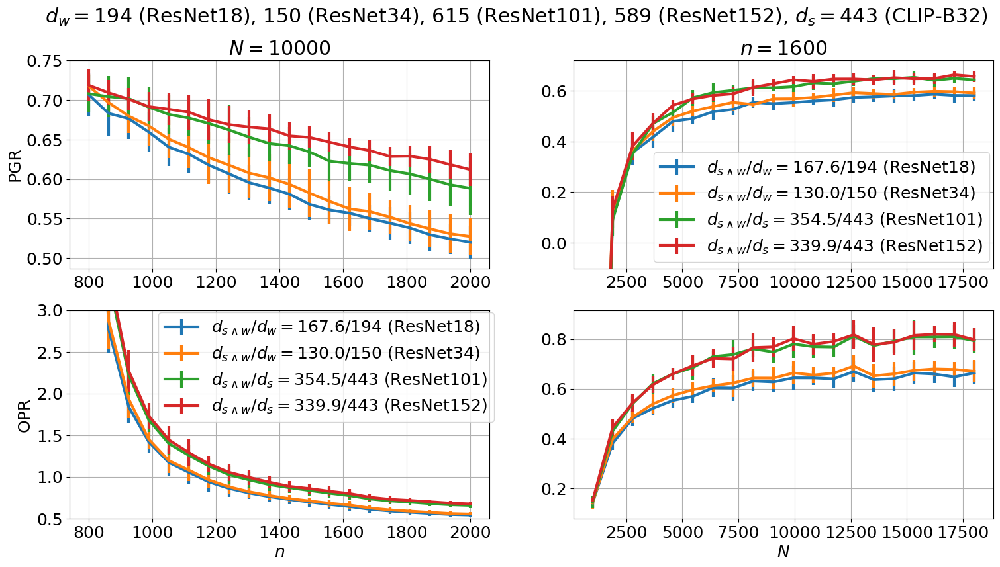

In [17]:
label_dict = {'pgr': 'PGR', 'opr': 'OPR'}
def plot_sample_scale(val_scal_N, val_scal_n, simulators, metrics=['pgr','opr'], ylog=False, legplot=[1,1]):
    fig = plt.figure(figsize=(18, 9))
    lgds = []
    
    for i_met, metric in enumerate(metrics):
        ax = fig.add_subplot(len(metrics), 2, 2*i_met+2)
        n = val_scal_N['n']
        NN = val_scal_N['NN']
        for i, simulator in enumerate(simulators):
            val = val_scal_N[metric][0][i]
            val_std = val_scal_N[metric][1][i]
            ds = simulator.ds
            dw = simulator.dw
            dsw = simulator.dsw
            teacher_label = model_label_dict[simulator.weak_tag]
            if ds < dw:
                line = ax.errorbar(NN, val, yerr=val_std, label=r'$d_{s \wedge w}/d_s'f'={dsw:.1f}/{ds}$ ({teacher_label})', fmt='-')
            else:
                line = ax.errorbar(NN, val, yerr=val_std, label=r'$d_{s \wedge w}/d_w'f'={dsw:.1f}/{dw}$ ({teacher_label})', fmt='-')
            # bd = bounds_dict[metric](n, NN, simulators[i])
            # ax.plot(NN, bd, label=r'$d_{s \wedge w}'f'={dsw}$ Bound', color=line[0].get_color(), linestyle=':')
        if ylog:
            ax.set_yscale('log')
        if i_met == len(metrics)-1:
            ax.set_xlabel("$N$")
        if i_met == 0:
            ax.set_title(f'$n={n}$')
        if legplot[i_met]==2:
            handles, labels = ax.get_legend_handles_labels()
            lgd = ax.legend(handles, labels, loc='lower right', bbox_to_anchor=(1.01, -0.01), ncol=1)
        if metric=='pgr':
            ax.set_ylim([-0.1, 0.72])

        ax = fig.add_subplot(len(metrics), 2, 2*i_met+1)
        N = val_scal_n['N']
        nn = val_scal_n['nn']
        for i, simulator in enumerate(simulators):
            val = val_scal_n[metric][0][i]
            val_std = val_scal_n[metric][1][i]
            ds = simulator.ds
            dw = simulator.dw
            dsw = simulator.dsw
            teacher_label = model_label_dict[simulator.weak_tag]
            if ds < dw:
                line = ax.errorbar(nn, val, yerr=val_std, label=r'$d_{s \wedge w}/d_s'f'={dsw:.1f}/{ds}$ ({teacher_label})', fmt='-')
            else:
                line = ax.errorbar(nn, val, yerr=val_std, label=r'$d_{s \wedge w}/d_w'f'={dsw:.1f}/{dw}$ ({teacher_label})', fmt='-')
            # bd = bounds_dict[metric](nn, N, simulators[i])
            # ax.plot(nn, bd, label=r'$d_{s \wedge w}'f'={dsw}$ Bound', color=line[0].get_color(), linestyle=':')
        if ylog:
            ax.set_yscale('log')
        if i_met == len(metrics)-1:
            ax.set_xlabel("$n$")
        if i_met == 0:
            ax.set_title(f'$N={N}$')
        ax.set_ylabel(label_dict[metric])
        if metric=='opr':
            ax.set_ylim([0.5, 3.0])
        if legplot[i_met]==1:
            handles, labels = ax.get_legend_handles_labels()
            lgd = ax.legend(handles, labels, loc='upper right', bbox_to_anchor=(1.03, 1.03), ncol=1)
    
    lgds.append(lgd)    
    ds = simulators[0].ds
    # var = simulators[0].var
    dws2str = ', '.join([f'${simulator.dw:d}$ ({model_label_dict[simulator.weak_tag]})' for simulator in simulators])
    # dsws2str = ', '.join([f'{simulator.dsw.item():.0f}' for simulator in simulators])
    # esterr_w = torch.max(torch.tensor([simulator.esterr_w for simulator in simulators]))
    # esterr_s = torch.max(torch.tensor([simulator.esterr_s for simulator in simulators]))
    # strw2s = r'{s \wedge w}'
    student_label = model_label_dict[simulators[0].strong_tag]
    fig.suptitle(rf'$d_w=${dws2str}, $d_s={ds}$ ({student_label})', y=0.97)
    return fig, lgds


fig, lgds = plot_sample_scale(val_scal_N, val_scal_n, simulators, legplot=[2,1])

## Save

In [13]:
# save
# with open(f'./results/{name}.pkl', 'wb') as f:
#     pickle.dump((val_scal_N, val_scal_n), f)    
# print(f'Saved to ./results/{name}.pkl')

# Variance

## Run

In [18]:
ridge = 1e-6
# nstart = 1000
nstart = 1600
N_min = 1000
N_max = 18000

Nstart = 10000
n_min = 800
n_max = 2000

strong_tag = 'clipb32'
weak_tag = 'resnet50'
sigmas = [0.0, 5.0, 10.0, 20.0]
simulators = [W2S_UTKFace(args, weak_tag=weak_tag, strong_tag=strong_tag, ridge=ridge, noise=sigma) for sigma in sigmas]
val_scal_N, val_scal_n = simulation_sample_scale_dsw(simulators, n_range=[n_min, n_max], N_range=[N_min, N_max], nstart=nstart, Nstart=Nstart, trials=10, npts=20)

sigma_str = '-'.join([f'{sigma:.0f}' for sigma in sigmas])
name = f'utkface_{weak_tag}_{strong_tag}_noise{sigma_str}_ridge{ridge}_n{n_min}-{n_max}_N{N_min}-{N_max}_nstart{nstart}_Nstart{Nstart}'
# with open(f'./results/{name}.pkl', 'rb') as f:
#     val_scal_N, val_scal_n = pickle.load(f)

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


## Plot

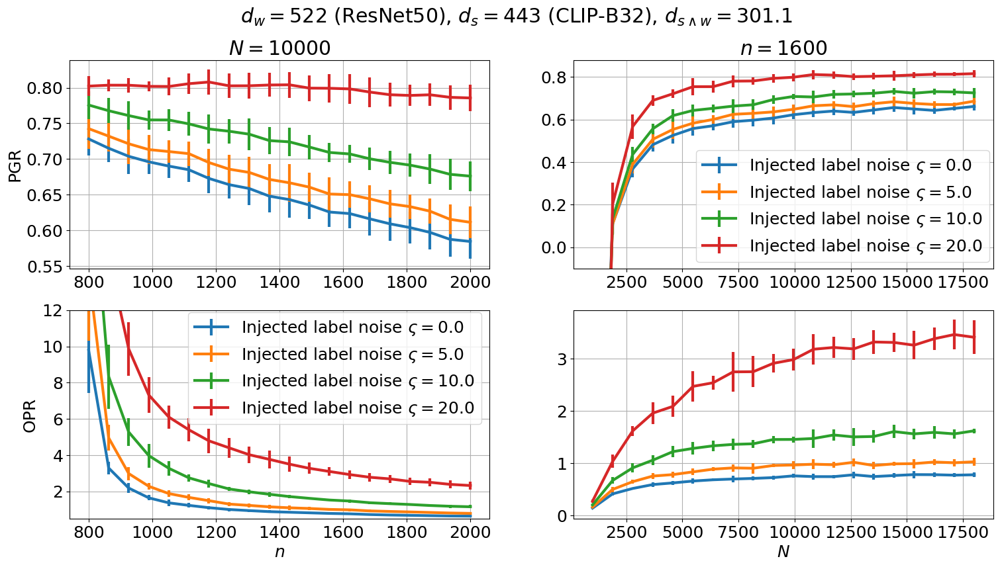

In [24]:
label_dict = {'pgr': 'PGR', 'opr': 'OPR'}
def plot_sample_scale(val_scal_N, val_scal_n, simulators, metrics=['pgr','opr'], ylog=False, legplot=[1,1]):
    fig = plt.figure(figsize=(18, 9))
    lgds = []
    
    for i_met, metric in enumerate(metrics):
        ax = fig.add_subplot(len(metrics), 2, 2*i_met+2)
        n = val_scal_N['n']
        NN = val_scal_N['NN']
        for i, simulator in enumerate(simulators):
            val = val_scal_N[metric][0][i]
            val_std = val_scal_N[metric][1][i]
            ds = simulator.ds
            dw = simulator.dw
            noise = simulator.noise
            line = ax.errorbar(NN, val, yerr=val_std, label=rf'Injected label noise $\varsigma={noise:.1f}$', fmt='-')
        if ylog:
            ax.set_yscale('log')
        if i_met == len(metrics)-1:
            ax.set_xlabel("$N$")
        if i_met == 0:
            ax.set_title(f'$n={n}$')
        if legplot[i_met]==2:
            handles, labels = ax.get_legend_handles_labels()
            lgd = ax.legend(handles, labels, loc='lower right', bbox_to_anchor=(1.01, -0.01), ncol=1)
        if metric=='pgr':
            ax.set_ylim([-0.1, 0.88])

        ax = fig.add_subplot(len(metrics), 2, 2*i_met+1)
        N = val_scal_n['N']
        nn = val_scal_n['nn']
        for i, simulator in enumerate(simulators):
            val = val_scal_n[metric][0][i]
            val_std = val_scal_n[metric][1][i]
            ds = simulator.ds
            dw = simulator.dw
            noise = simulator.noise
            line = ax.errorbar(nn, val, yerr=val_std, label=rf'Injected label noise $\varsigma={noise:.1f}$', fmt='-')
        if ylog:
            ax.set_yscale('log')
        if i_met == len(metrics)-1:
            ax.set_xlabel("$n$")
        if i_met == 0:
            ax.set_title(f'$N={N}$')
        ax.set_ylabel(label_dict[metric])
        if metric=='opr':
            ax.set_ylim([0.5, 12.0])
        if legplot[i_met]==1:
            handles, labels = ax.get_legend_handles_labels()
            lgd = ax.legend(handles, labels, loc='upper right', bbox_to_anchor=(1.0, 1.03), ncol=1)
        
    ds = simulators[0].ds
    teacher_tag = model_label_dict[simulators[0].weak_tag]
    student_tag = model_label_dict[simulators[0].strong_tag]
    ds = simulators[0].ds
    dw = simulators[0].dw
    dsw = simulators[0].dsw
    student_label = model_label_dict[simulators[0].strong_tag]
    fig.suptitle(rf'$d_w = {dw}$ ({teacher_tag}), $d_s = {ds}$ ({student_tag}), $d_'r'{s \wedge w}'rf' = {dsw:.1f}$', y=0.97)
    return fig, lgds

fig, lgds = plot_sample_scale(val_scal_N, val_scal_n, simulators, legplot=[2,1])

## Save

In [20]:
# save
# with open(f'./results/{name}.pkl', 'wb') as f:
#     pickle.dump((val_scal_N, val_scal_n), f)    
# print(f'Saved to ./results/{name}.pkl')

Saved to ./results/utkface_resnet50_clipb32_noise0-5-10-20_ridge1e-06_n800-2000_N1000-18000_nstart1600_Nstart10000.pkl
